<center><h2>MQTT IoT Intrusion Detection</h2></center>

# Build and populate Postgres Database table


<h3>Data Ingesting from the Source</h3>

In [2]:
%%html
<style>
div.output_area pre {
    white-space: pre;
}
</style>

In [ ]:
%pip install pyspark

Note: you may need to restart the kernel to use updated packages.


In [96]:
import pyspark
from pyspark import SparkContext, SparkConf, SQLContext
from pyspark.sql import SparkSession
from pyspark.sql.functions import *

from pyspark import SparkFiles

spark = SparkSession.builder \
    .master("local[*]") \
    .appName("GenericAppName") \
    .getOrCreate()

In [97]:
# MQTT Dataset

#train_path = ""
train_path = "/my/path//Data/train70_augmented.csv"
train_df = spark.read.csv(train_path, header=True, inferSchema=True)

#test_path = ""
test_path = "/my/path/Data//test30_augmented.csv"
test_df = spark.read.csv(test_path, header=True, inferSchema=True)

In [98]:
train_df.printSchema() 

root
 |-- tcp.flags: string (nullable = true)
 |-- tcp.time_delta: double (nullable = true)
 |-- tcp.len: integer (nullable = true)
 |-- mqtt.conack.flags: string (nullable = true)
 |-- mqtt.conack.flags.reserved: double (nullable = true)
 |-- mqtt.conack.flags.sp: double (nullable = true)
 |-- mqtt.conack.val: double (nullable = true)
 |-- mqtt.conflag.cleansess: double (nullable = true)
 |-- mqtt.conflag.passwd: double (nullable = true)
 |-- mqtt.conflag.qos: double (nullable = true)
 |-- mqtt.conflag.reserved: double (nullable = true)
 |-- mqtt.conflag.retain: double (nullable = true)
 |-- mqtt.conflag.uname: double (nullable = true)
 |-- mqtt.conflag.willflag: double (nullable = true)
 |-- mqtt.conflags: string (nullable = true)
 |-- mqtt.dupflag: double (nullable = true)
 |-- mqtt.hdrflags: string (nullable = true)
 |-- mqtt.kalive: double (nullable = true)
 |-- mqtt.len: double (nullable = true)
 |-- mqtt.msg: string (nullable = true)
 |-- mqtt.msgid: double (nullable = true)
 |-

In [99]:
train_df.show()

+----------+--------------+-------+-----------------+--------------------------+--------------------+---------------+----------------------+-------------------+----------------+---------------------+-------------------+------------------+---------------------+-------------+------------+-------------+-----------+--------+--------+----------+------------+--------------+--------------+--------+-----------+------------+---------------+--------+------------+----------------+--------------+------------------+----------+
| tcp.flags|tcp.time_delta|tcp.len|mqtt.conack.flags|mqtt.conack.flags.reserved|mqtt.conack.flags.sp|mqtt.conack.val|mqtt.conflag.cleansess|mqtt.conflag.passwd|mqtt.conflag.qos|mqtt.conflag.reserved|mqtt.conflag.retain|mqtt.conflag.uname|mqtt.conflag.willflag|mqtt.conflags|mqtt.dupflag|mqtt.hdrflags|mqtt.kalive|mqtt.len|mqtt.msg|mqtt.msgid|mqtt.msgtype|mqtt.proto_len|mqtt.protoname|mqtt.qos|mqtt.retain|mqtt.sub.qos|mqtt.suback.qos|mqtt.ver|mqtt.willmsg|mqtt.willmsg_len|mqtt.w

In [100]:
train_df.schema

StructType(List(StructField(tcp.flags,StringType,true),StructField(tcp.time_delta,DoubleType,true),StructField(tcp.len,IntegerType,true),StructField(mqtt.conack.flags,StringType,true),StructField(mqtt.conack.flags.reserved,DoubleType,true),StructField(mqtt.conack.flags.sp,DoubleType,true),StructField(mqtt.conack.val,DoubleType,true),StructField(mqtt.conflag.cleansess,DoubleType,true),StructField(mqtt.conflag.passwd,DoubleType,true),StructField(mqtt.conflag.qos,DoubleType,true),StructField(mqtt.conflag.reserved,DoubleType,true),StructField(mqtt.conflag.retain,DoubleType,true),StructField(mqtt.conflag.uname,DoubleType,true),StructField(mqtt.conflag.willflag,DoubleType,true),StructField(mqtt.conflags,StringType,true),StructField(mqtt.dupflag,DoubleType,true),StructField(mqtt.hdrflags,StringType,true),StructField(mqtt.kalive,DoubleType,true),StructField(mqtt.len,DoubleType,true),StructField(mqtt.msg,StringType,true),StructField(mqtt.msgid,DoubleType,true),StructField(mqtt.msgtype,DoubleTyp

<h3>Data Cleaning</h3>

In [101]:
def removePeriodsColRename(data):
  '''
  Renames Columns by substituting periods with underscores

  data: dataFrame (PySpark)

  '''

  for column in range(len(data.dtypes)):
    if "." in data.dtypes[column][0]:
      data = data.withColumnRenamed(data.dtypes[column][0], test_df.dtypes[column][0].replace(".", "_"))

  return data

In [102]:
# Rename Columns
train_df = removePeriodsColRename(train_df)
test_df = removePeriodsColRename(test_df)


<h3>Check Null and NaN Values</h3>

In [103]:
train_df_null_check = train_df

null_counts_df = train_df_null_check.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) \
                        for c in train_df_null_check.columns])

null_counts_df.show(truncate=False, vertical=True)

-RECORD 0-------------------------
 tcp_flags                  | 0   
 tcp_time_delta             | 0   
 tcp_len                    | 0   
 mqtt_conack_flags          | 0   
 mqtt_conack_flags_reserved | 0   
 mqtt_conack_flags_sp       | 0   
 mqtt_conack_val            | 0   
 mqtt_conflag_cleansess     | 0   
 mqtt_conflag_passwd        | 0   
 mqtt_conflag_qos           | 0   
 mqtt_conflag_reserved      | 0   
 mqtt_conflag_retain        | 0   
 mqtt_conflag_uname         | 0   
 mqtt_conflag_willflag      | 0   
 mqtt_conflags              | 0   
 mqtt_dupflag               | 0   
 mqtt_hdrflags              | 0   
 mqtt_kalive                | 0   
 mqtt_len                   | 0   
 mqtt_msg                   | 0   
 mqtt_msgid                 | 0   
 mqtt_msgtype               | 0   
 mqtt_proto_len             | 0   
 mqtt_protoname             | 0   
 mqtt_qos                   | 0   
 mqtt_retain                | 0   
 mqtt_sub_qos               | 0   
 mqtt_suback_qos    

In [104]:
# Collect Unique Row Values for each column to help determine proper schema and 
# columns to drop if only 1 unique value is found 
# and identify boolean categorical values if only 2 unique values are found

print("Collecting Unique Column Values")
column_unique_dict ={}

for column in train_df.dtypes:
  print(column[0])
  unique_vals = train_df.select(column[0]).distinct().collect()
  if len(unique_vals) == 1:
    print("Only 1 unique column value, consider dropping")
  if len(unique_vals) == 2:
    print("Only 2 unique column values, likely binary categorical variables")
  column_unique_dict[column[0]] = unique_vals


tcp_flags


tcp_time_delta


tcp_len


mqtt_conack_flags


Only 2 unique column values, likely binary categorical variables
mqtt_conack_flags_reserved


Only 1 unique column value, consider dropping
mqtt_conack_flags_sp


Only 1 unique column value, consider dropping
mqtt_conack_val


Only 2 unique column values, likely binary categorical variables
mqtt_conflag_cleansess


Only 2 unique column values, likely binary categorical variables
mqtt_conflag_passwd


Only 2 unique column values, likely binary categorical variables
mqtt_conflag_qos


Only 1 unique column value, consider dropping
mqtt_conflag_reserved


Only 1 unique column value, consider dropping
mqtt_conflag_retain


Only 1 unique column value, consider dropping
mqtt_conflag_uname


Only 2 unique column values, likely binary categorical variables
mqtt_conflag_willflag


Only 1 unique column value, consider dropping
mqtt_conflags


mqtt_dupflag


Only 2 unique column values, likely binary categorical variables
mqtt_hdrflags


mqtt_kalive


mqtt_len


mqtt_msg


mqtt_msgid


mqtt_msgtype


mqtt_proto_len


Only 2 unique column values, likely binary categorical variables
mqtt_protoname


Only 2 unique column values, likely binary categorical variables
mqtt_qos


Only 2 unique column values, likely binary categorical variables
mqtt_retain


Only 2 unique column values, likely binary categorical variables
mqtt_sub_qos


Only 1 unique column value, consider dropping
mqtt_suback_qos


Only 1 unique column value, consider dropping
mqtt_ver


Only 2 unique column values, likely binary categorical variables
mqtt_willmsg


Only 1 unique column value, consider dropping
mqtt_willmsg_len


Only 1 unique column value, consider dropping
mqtt_willtopic


Only 1 unique column value, consider dropping
mqtt_willtopic_len


Only 1 unique column value, consider dropping
target


In [105]:
# Drop Columns with only 1 Unique Value
train_df = train_df.drop("mqtt_conack_flags_reserved", "mqtt_conack_flags_sp", "mqtt_conflag_qos", "mqtt_conflag_reserved", "mqtt_conflag_retain", \
              "mqtt_conflag_willflag", "mqtt_sub_qos", "mqtt_suback_qos", "mqtt_willmsg", "mqtt_willmsg_len", "mqtt_willtopic", \
              "mqtt_willtopic_len")

test_df = test_df.drop("mqtt_conack_flags_reserved", "mqtt_conack_flags_sp", "mqtt_conflag_qos", "mqtt_conflag_reserved", "mqtt_conflag_retain", \
              "mqtt_conflag_willflag", "mqtt_sub_qos", "mqtt_suback_qos", "mqtt_willmsg", "mqtt_willmsg_len", "mqtt_willtopic", \
              "mqtt_willtopic_len")

In [106]:
train_df.printSchema()

root
 |-- tcp_flags: string (nullable = true)
 |-- tcp_time_delta: double (nullable = true)
 |-- tcp_len: integer (nullable = true)
 |-- mqtt_conack_flags: string (nullable = true)
 |-- mqtt_conack_val: double (nullable = true)
 |-- mqtt_conflag_cleansess: double (nullable = true)
 |-- mqtt_conflag_passwd: double (nullable = true)
 |-- mqtt_conflag_uname: double (nullable = true)
 |-- mqtt_conflags: string (nullable = true)
 |-- mqtt_dupflag: double (nullable = true)
 |-- mqtt_hdrflags: string (nullable = true)
 |-- mqtt_kalive: double (nullable = true)
 |-- mqtt_len: double (nullable = true)
 |-- mqtt_msg: string (nullable = true)
 |-- mqtt_msgid: double (nullable = true)
 |-- mqtt_msgtype: double (nullable = true)
 |-- mqtt_proto_len: double (nullable = true)
 |-- mqtt_protoname: string (nullable = true)
 |-- mqtt_qos: double (nullable = true)
 |-- mqtt_retain: double (nullable = true)
 |-- mqtt_ver: double (nullable = true)
 |-- target: string (nullable = true)



In [107]:
def uniqueRowValCount(data, col_name):
  # data: column of pySpark DataFrame
  # col_name: name of column 

  # Unique Row Values
  unique_vals = data.select(col_name).distinct().collect()

  count_list = []

  # Iterate through the uniquely valued rows
  for i in range(len(unique_vals)): 

    unique_rows = data.filter(col(col_name) == unique_vals[i][col_name])
    count_list.append((unique_vals[i][col_name], unique_rows.count()))

  return sorted(count_list, key = lambda x: x[1], reverse = True)

In [108]:
# Not Recommended to Run with entire dataset or with cols 'mqtt_msg' or 'mqtt_msgid'
# Will take VERY long

# For demonstration purposes, this function will show output for a single column,
# but can easily be adapted to run through every column by providing a list of column names
# and looping through each passed to the uniqueRowValCount()

# for column in train_df.dtypes:
#     counts = uniqueRowValCount(train_df, column)

#     print("Count of each unique values in train data:")
#     for j in counts:
#       print(j)


counts = uniqueRowValCount(train_df, "mqtt_ver")

print("Count of each unique values in train data:")
for j in counts:
  print(j)

Count of each unique values in train data:
(0.0, 13609360)
(4.0, 390640)


mqtt_conack_flags: string (binary)

Count of each unique values in train data:
* ('0', 13609885)
* ('0x00000000', 390115)

mqtt_conack_val: double (binary)

Count of each unique values in train data:
* (0.0, 13860800)
* (5.0, 139200)

mqtt_conflag_cleansess: double (binary)

Count of each unique values in train data:
* (0.0, 13609360)
* (1.0, 390640)

mqtt_conflag_passwd: double (binary)

Count of each unique values in train data:
* (0.0, 13861600)
* (1.0, 138400)

mqtt_conflag_uname: double (binary)

Count of each unique values in train data:
* (0.0, 13861200)
* (1.0, 138800)

mqtt_conflags: string (nominal)

Count of each unique values in train data:
* ('0', 13609360)
* ('0x00000002', 251840)
* ('0x000000c2', 138400)
* ('0x00000082', 400)

mqtt_dupflag: double (binary)

Count of each unique values in train data:
* (0.0, 13799002)
* (1.0, 200998)

mqtt_hdrflags: string (nominal)

Count of each unique values in train data:
* ('0', 6856327)
* ('0x00000030', 5183544)
* ('0x00000040', 423021)
* ('0x00000010', 390640)
* ('0x00000020', 390115)
* ('0x00000032', 384096)
* ('0x0000003a', 200998)
* ('0x000000d0', 64840)
* ('0x000000c0', 64840)
* ('0x00000031', 15540)
* ('0x00000090', 10367)
* ('0x00000082', 10367)
* ('0x00000050', 5040)
* ('0x000000e0', 265)

mqtt_kalive: double (nominal)

Count of each unique values in train data:
* (0.0, 13609360)
* (60.0, 226595)
* (65535.0, 143325)
* (234.0, 5180)
* (1.0, 5180)
* (3.0, 5180)
* (2.0, 5180)

mqtt_len: double (continuos)

* Contains 92 unique values

mqtt_msg: string (nominal) (Is this useful?, consider droping)

* Contains 50322 unique values

mqtt_msgid: double (nominal)(Is this useful?, consider droping)

* Contains 9999 unique values 

mqtt_msgtype: double (already string indexed) ready for OHE -> (nominal)
* 8.0
* 0.0
* 1.0
* 4.0
* 14.0
* 3.0
* 2.0
* 13.0
* 5.0
* 9.0
* 12.0


mqtt_proto_len: double (binary)

Count of each unique values in train data:
* (0.0, 13609360)
* (4.0, 390640)

mqtt_protoname: string (binary) (Need to encode 'MQTT' to 1 and change column to numerical type for binary)

Count of each unique values in train data:
* ('0', 13609360)
* ('MQTT', 390640)

mqtt_qos: double (binary)

Count of each unique values in train data:
* (0.0, 13414906)
* (1.0, 585094)

mqtt_retain: double (binary)

Count of each unique values in train data:
* (0.0, 13984460)
* (1.0, 15540)

mqtt_ver: double (binary)

Count of each unique values in train data:
* (0.0, 13609360)
* (4.0, 390640)

In [109]:
# Dropping 'mqtt_msgid', 'mqtt_msg' since as nominal variables they will unnecessarilly explode
# the size of the feature vector later on, Occam's razor

train_df = train_df.drop('mqtt_msgid', 'mqtt_msg')
test_df = test_df.drop('mqtt_msgid', 'mqtt_msg')

In [110]:
from pyspark.sql.functions import lit 

# Add train and test partitions before uploading to postgresql in single table
train_df = train_df.withColumn("partition", lit("train"))
test_df = test_df.withColumn("partition", lit("test"))

In [111]:
train_df.printSchema()

root
 |-- tcp_flags: string (nullable = true)
 |-- tcp_time_delta: double (nullable = true)
 |-- tcp_len: integer (nullable = true)
 |-- mqtt_conack_flags: string (nullable = true)
 |-- mqtt_conack_val: double (nullable = true)
 |-- mqtt_conflag_cleansess: double (nullable = true)
 |-- mqtt_conflag_passwd: double (nullable = true)
 |-- mqtt_conflag_uname: double (nullable = true)
 |-- mqtt_conflags: string (nullable = true)
 |-- mqtt_dupflag: double (nullable = true)
 |-- mqtt_hdrflags: string (nullable = true)
 |-- mqtt_kalive: double (nullable = true)
 |-- mqtt_len: double (nullable = true)
 |-- mqtt_msgtype: double (nullable = true)
 |-- mqtt_proto_len: double (nullable = true)
 |-- mqtt_protoname: string (nullable = true)
 |-- mqtt_qos: double (nullable = true)
 |-- mqtt_retain: double (nullable = true)
 |-- mqtt_ver: double (nullable = true)
 |-- target: string (nullable = true)
 |-- partition: string (nullable = false)



In [112]:
# In order to prevent memory errors with ingestion into PostgreSQL,
# a smaller subset of the same ratio (70% train, 30% test) will be used.
# This will also reduce the time needed for hyper-parameter tuning with cross-validation. 

# Since I want to check for outliers, I will begin with a larger subset in case outliers of 4 
# or higher are found and a reduced subset will be selecting to ensure the train/test ratio
train_df_T2 = train_df # Keep Full-size for finding statistics from train set 
                       # Full-size is not saved in PostgreSQL due to OOM error

train_df = train_df.limit(280000)
test_df = test_df.limit(120000)

<h2>Handling Outliers</h2>

In [113]:
from functools import reduce

def column_add(a,b):
     return  a.__add__(b)
    
def find_outliers(df):
    # Identifying the numerical columns in a spark dataframe
    numeric_columns = [column[0] for column in df.dtypes if column[1]=='int']

    # Using the `for` loop to create new columns by identifying the outliers for each feature
    for column in numeric_columns:

        less_Q1 = 'less_Q1_{}'.format(column)
        more_Q3 = 'more_Q3_{}'.format(column)
        Q1 = 'Q1_{}'.format(column)
        Q3 = 'Q3_{}'.format(column)

        # Q1 : First Quartile ., Q3 : Third Quartile
        Q1 = df.approxQuantile(column,[0.25],relativeError=0)
        Q3 = df.approxQuantile(column,[0.75],relativeError=0)
        
        # IQR : Inter Quantile Range
        # We need to define the index [0], as Q1 & Q3 are a set of lists., to perform a mathematical operation
        # Q1 & Q3 are defined seperately so as to have a clear indication on First Quantile & 3rd Quantile
        IQR = Q3[0] - Q1[0]
        
        #selecting the data, with -1.5*IQR to + 1.5*IQR., where param = 1.5 default value
        less_Q1 =  Q1[0] - 1.5*IQR
        more_Q3 =  Q3[0] + 1.5*IQR
        
        isOutlierCol = 'is_outlier_{}'.format(column)
        
        df = df.withColumn(isOutlierCol,when((df[column] > more_Q3) | (df[column] < less_Q1), 1).otherwise(0))
    

    # Selecting the specific columns which we have added above, to check if there are any outliers
    selected_columns = [column for column in df.columns if column.startswith("is_outlier")]
    # Adding all the outlier columns into a new colum "total_outliers", to see the total number of outliers
    df = df.withColumn('total_outliers',reduce(column_add, ( df[col] for col in  selected_columns)))

    # Dropping the extra columns created above, just to create nice dataframe., without extra columns
    df = df.drop(*[column for column in df.columns if column.startswith("is_outlier")])

    return df

In [114]:
df = train_df.union(test_df)

In [115]:
outliers_df = find_outliers(df)

In [116]:
outliers_df.groupby("total_outliers").count().show()

+--------------+------+
|total_outliers| count|
+--------------+------+
|             1| 39200|
|             0|360800|
+--------------+------+




[Stage 734:================================================>        (6 + 1) / 7]



In [117]:
# Outliers do not exceed 3, so filter will not remove samples in this case
df_with_handled_outliers = outliers_df.\
        filter(outliers_df['total_Outliers']<=4)
print(df_with_handled_outliers.count())

400000


In [118]:
train_df = df_with_handled_outliers.where(col("partition") == "train")
test_df = df_with_handled_outliers.where(col("partition") == "test")

# Smaller Subset as seen in course-project-option-2-sample-2 by Surya Balaji and Saroj Sathish
train_df = train_df.limit(140000)
test_df = test_df.limit(60000)

<h2>Data Ingestion to Stable Storage</h2>

**Skip while running on the Cloud**

In [84]:
db_properties={}
#update your db username
db_properties['username']="postgres"
#update your db password
db_properties['password']="bigdata"
#make sure you got the right port number here
db_properties['url']= "jdbc:postgresql://localhost:5432/postgres"
#make sure you had the Postgres JAR file in the right location
db_properties['driver']="org.postgresql.Driver"
db_properties['table']= "mqtt"

In [16]:
# Ingest Train Dataset into Postgres
train_df.write.format("jdbc")\
.mode("overwrite")\
.option("url", db_properties['url'])\
.option("dbtable", db_properties['table'])\
.option("user", db_properties['username'])\
.option("password", db_properties['password'])\
.option("Driver", db_properties['driver'])\
.save()

# Ingest Test Dataset into Postgres
test_df.write.format("jdbc")\
.mode("append")\
.option("url", db_properties['url'])\
.option("dbtable", db_properties['table'])\
.option("user", db_properties['username'])\
.option("password", db_properties['password'])\
.option("Driver", db_properties['driver'])\
.save()

22/11/27 15:27:01 WARN package: Truncated the string representation of a plan since it was too large. This behavior can be adjusted by setting 'spark.sql.debug.maxToStringFields'.


In [119]:
# Read data back from Postgres
sc=spark.sparkContext
sqlContext = SQLContext(sc)

df_read = sqlContext.read.format("jdbc")\
    .option("url", db_properties['url'])\
    .option("dbtable", db_properties['table'])\
    .option("user", db_properties['username'])\
    .option("password", db_properties['password'])\
    .option("Driver", db_properties['driver'])\
    .load()


In [120]:
type(df_read)

pyspark.sql.dataframe.DataFrame

In [121]:
train_df = df_read.where(col("partition") == "train")
test_df = df_read.where(col("partition") == "test")

# Data analysis with PySpark

* Average length of an MQTT message captured in the train dataset
* Average length of the TCP message for each target
* Most frequent X TCP flags
* Most popular target on Twitter?

In [122]:
def avg_msg_len_MQTT(data):

     return data.select("mqtt_len").groupBy().mean("mqtt_len")

In [123]:
print("Average length of MQTT message in train dataset:")
avg_msg_len_MQTT(train_df_T2).show()

Average length of MQTT message in train dataset:


+------------------+
|     avg(mqtt_len)|
+------------------+
|12.373630642857142|
+------------------+




[Stage 751:================================================>      (15 + 2) / 17]



In [124]:
# Average length of the TCP message for each target
def avg_msg_len_TCP_per_target(data):
    '''
    Input:
        data: PySpark DataFrame
        
    Output: 
        avg_tcp_len: PySpark DataFrame 
          Average tcp message length per target
           
    '''
    avg_tcp_len = data.groupBy("target").mean("tcp_len")
    
    return avg_tcp_len

In [125]:
avg_tcp_len = avg_msg_len_TCP_per_target(train_df_T2)
avg_tcp_len.show()

+----------+------------------+
|    target|      avg(tcp_len)|
+----------+------------------+
|   slowite|             3.702|
|bruteforce|3.2535714285714286|
|     flood|         13487.218|
| malformed|           21.3381|
|       dos| 312.4009314285714|
|legitimate| 7.784368142857143|
+----------+------------------+




[Stage 754:===================================================>   (16 + 1) / 17]



In [126]:
def mostFrequentTCP(data, X):
  '''
  input:
    data: DataFrame (PySpark)

  return:
    counts[:X]: list of tuples
      Top X most Frequent TCP Flags
  '''

  counts = uniqueRowValCount(data, "tcp_flags")

  return counts[:X]

In [127]:
# Example where X=4, returns the top 4 most frequent TCP flags
top_X_counts = mostFrequentTCP(train_df_T2, X=4)

print("Top X (e.g. X=4) most frequent tcp_flags in train data:")
for j in top_X_counts:
  print(j)

Top X (e.g. X=4) most frequent tcp_flags in train data:
('0x00000018', 6933289)
('0x00000010', 5457261)
('0x00000002', 437015)
('0x00000012', 436875)


In [128]:
counts = uniqueRowValCount(train_df_T2, "target")

print("Count of each unique target in train data:")
for j in counts:
  print(j)

Count of each unique target in train data:
('legitimate', 7000000)
('slowite', 1400000)
('bruteforce', 1400000)
('flood', 1400000)
('malformed', 1400000)
('dos', 1400000)


In [129]:
# Unique Targets to Search twitter:
unique_targets = train_df_T2.select("target").distinct().collect()

for target in unique_targets:
  print(target[0])

slowite
bruteforce
flood
malformed
dos
legitimate


## Most Popular Target on Twitter

In [2]:
%pip install kafka-python
%pip install tweepy

     |████████████████████████████████| 246 kB 4.4 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.
     |████████████████████████████████| 101 kB 2.6 MB/s ta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [2]:
from kafka import KafkaConsumer
import json

topic_name = 'mqttProject'

kafka_consumer = KafkaConsumer(
    topic_name,
    bootstrap_servers=['localhost:9092'],
    auto_offset_reset='latest',
    enable_auto_commit=True,
    auto_commit_interval_ms =  5000,
    fetch_max_bytes = 128,
    max_poll_records = 100,
    value_deserializer=lambda x: x.decode('utf-8'))

In [5]:
import unidecode
import time

search_terms = ["legitimate", "slowite", "bruteforce", "flood", "malformed", "dos"]
count_dict = {k: 0 for k in search_terms}

start = time.time()
for message in kafka_consumer:
    stop = time.time()
    stopwatch = (stop-start)/60
    
    if stopwatch > 5: # 5-min Twitter Feed
        break
        
    # Read the tweet from the topic
    data = [message.value]
    #print(data)
    # string handling, lowercase and remove accents
    normed_tweet = unidecode.unidecode(data[0].lower())
    for term in search_terms:
        # Only considering appearance within string, not number of appearances
        if term in normed_tweet: 
            count_dict[term] = count_dict[term]+1

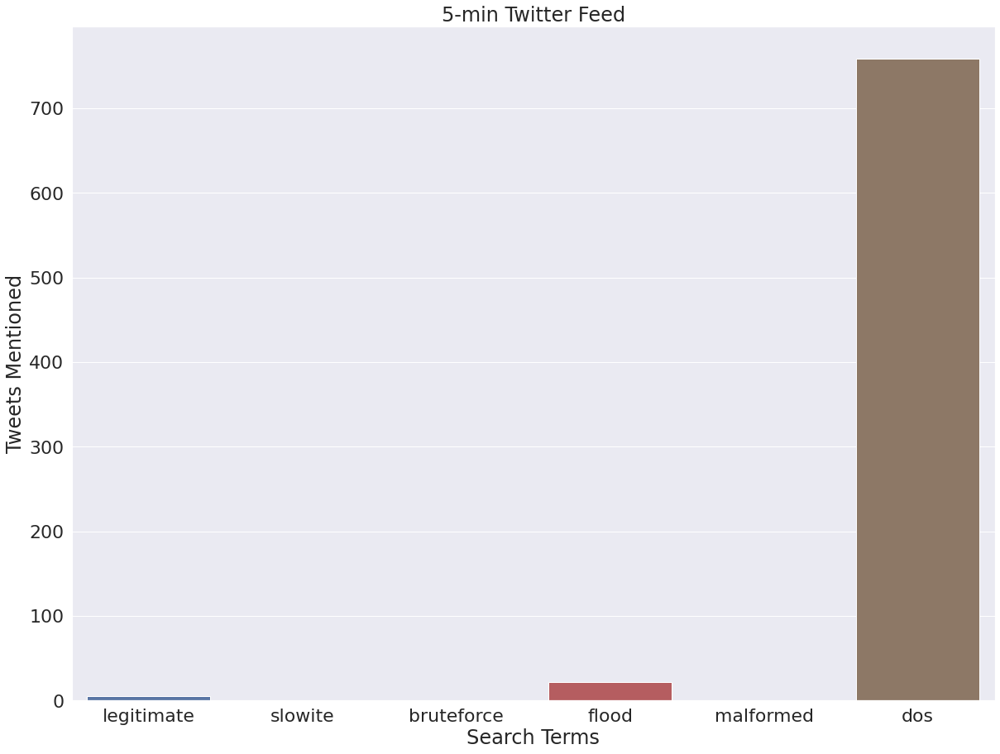

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns
from IPython import display
import pandas as pd 

plt.figure( figsize = ( 20, 15 ) )
sns.set(font_scale=2)

count_df = pd.DataFrame.from_dict([count_dict])

ax = sns.barplot(data=count_df)
ax.set(xlabel='Search Terms', ylabel='Tweets Mentioned', title="5-min Twitter Feed")
plt.show()

Most Popular Target is DOS

# Machine Learning Modeling 

- Goal: Predict the type of the attack
  - Uses feature engineering principles (including data cleaning and data engineering)
  - Models built with Spark and Tensorflow.





<h2>Correlations</h2>

<ul>
    <li>Distributions show visual correlation of variables and we identified two possible columns to be dropped. Let's take a look at the correlation between all the variables and find the variables with strong correlation.</li>
    <li><b>Strong correlation</b> is identified with <b>>= 0.8 correlation coefficient.</b> </li>
    <li><b>In order for correlation to work, null values should be handled. </b></li>
    </ul>

In [45]:
# If running on Cloud, run this line to build df_read analogous to 
# what would be returned when reading data back from PostgreSQL Database

#df_read = train_df.union(test_df)

In [130]:
df_read.show()

+----------+--------------+-------+-----------------+---------------+----------------------+-------------------+------------------+-------------+------------+-------------+-----------+--------+------------+--------------+--------------+--------+-----------+--------+----------+---------+--------------+
| tcp_flags|tcp_time_delta|tcp_len|mqtt_conack_flags|mqtt_conack_val|mqtt_conflag_cleansess|mqtt_conflag_passwd|mqtt_conflag_uname|mqtt_conflags|mqtt_dupflag|mqtt_hdrflags|mqtt_kalive|mqtt_len|mqtt_msgtype|mqtt_proto_len|mqtt_protoname|mqtt_qos|mqtt_retain|mqtt_ver|    target|partition|total_outliers|
+----------+--------------+-------+-----------------+---------------+----------------------+-------------------+------------------+-------------+------------+-------------+-----------+--------+------------+--------------+--------------+--------+-----------+--------+----------+---------+--------------+
|0x00000018|      1.000039|     13|                0|            0.0|                   0.0

In [131]:
correlation_matrix = df_read.toPandas().corr()
print(correlation_matrix)

                        tcp_time_delta   tcp_len  mqtt_conack_val  \
tcp_time_delta                1.000000  0.043743        -0.010835   
tcp_len                       0.043743  1.000000        -0.022337   
mqtt_conack_val              -0.010835 -0.022337         1.000000   
mqtt_conflag_cleansess       -0.018337 -0.036929        -0.017269   
mqtt_conflag_passwd          -0.010795 -0.021668        -0.010164   
mqtt_conflag_uname           -0.010809 -0.021696        -0.010177   
mqtt_dupflag                 -0.010161 -0.011787        -0.011999   
mqtt_kalive                  -0.010987 -0.022479        -0.010347   
mqtt_len                     -0.014804  0.039723        -0.029172   
mqtt_msgtype                  0.304328  0.180686         0.023558   
mqtt_proto_len               -0.018337 -0.036929        -0.017269   
mqtt_qos                     -0.020147 -0.021820        -0.021021   
mqtt_retain                  -0.003716 -0.004109        -0.003531   
mqtt_ver                     -0.01

In the previous results, look for strong correlations among variables. Notice the following:



Strong Correlations among:
<ul>
    <li>mqtt_conflag_cleansess</li>
    <li>mqtt_proto_len</li>
    <li>mqtt_ver</li>
</ul>

Strong Correlations among:
<ul>
    <li>mqtt_conflag_uname</li>
    <li>mqtt_conflag_passwd</li>
</ul>

Strong Correlations among:
<ul>
    <li>mqtt_qos</li>
    <li>mqtt_len</li>
</ul>

<h3>So, we should keep one variable from each group</h3>

In [132]:
df_with_handled_correlations = df_read\
                .drop("mqtt_ver","mqtt_proto_len", "mqtt_conflag_uname", "mqtt_qos")

<h2>Handle Binary Variables (by casting them)</h2>

In [133]:
binary_cols_val_sub = ['mqtt_conack_flags', 'mqtt_conack_val', 'mqtt_protoname']
binary_val_sub_dict = {'mqtt_conack_flags':'0x00000000', 'mqtt_conack_val': '5', 'mqtt_protoname':'MQTT'}

df_binary_encode = df_with_handled_correlations
for bin_col in binary_cols_val_sub:
      
  df_binary_encode = (df_binary_encode\
      .withColumn(bin_col, \
                  when(df_binary_encode[bin_col]==binary_val_sub_dict[bin_col],\
                      regexp_replace(df_binary_encode[bin_col],binary_val_sub_dict[bin_col],"1")) \
                  .otherwise(df_binary_encode[bin_col]))\
                  )


In [134]:

binary_cols = ['mqtt_conack_flags', 'mqtt_conack_val', 'mqtt_conflag_cleansess', 'mqtt_conflag_passwd', 'mqtt_dupflag', 
               'mqtt_protoname','mqtt_retain']
               
df_with_handled_binary = df_binary_encode
for bin_col in binary_cols:
  df_with_handled_binary = (df_with_handled_binary
                .withColumn(bin_col+"_encoded", \
                            df_with_handled_binary[bin_col].cast("integer")).drop(bin_col))


df_with_handled_binary.show()

+----------+--------------+-------+-------------+-------------+-----------+--------+------------+----------+---------+--------------+-------------------------+-----------------------+------------------------------+---------------------------+--------------------+----------------------+-------------------+
| tcp_flags|tcp_time_delta|tcp_len|mqtt_conflags|mqtt_hdrflags|mqtt_kalive|mqtt_len|mqtt_msgtype|    target|partition|total_outliers|mqtt_conack_flags_encoded|mqtt_conack_val_encoded|mqtt_conflag_cleansess_encoded|mqtt_conflag_passwd_encoded|mqtt_dupflag_encoded|mqtt_protoname_encoded|mqtt_retain_encoded|
+----------+--------------+-------+-------------+-------------+-----------+--------+------------+----------+---------+--------------+-------------------------+-----------------------+------------------------------+---------------------------+--------------------+----------------------+-------------------+
|0x00000018|      1.000039|     13|            0|   0x00000030|        0.0|    


[Stage 810:>                                                        (0 + 1) / 1]



In [135]:
df_with_handled_binary.printSchema()

root
 |-- tcp_flags: string (nullable = true)
 |-- tcp_time_delta: double (nullable = true)
 |-- tcp_len: integer (nullable = true)
 |-- mqtt_conflags: string (nullable = true)
 |-- mqtt_hdrflags: string (nullable = true)
 |-- mqtt_kalive: double (nullable = true)
 |-- mqtt_len: double (nullable = true)
 |-- mqtt_msgtype: double (nullable = true)
 |-- target: string (nullable = true)
 |-- partition: string (nullable = true)
 |-- total_outliers: integer (nullable = true)
 |-- mqtt_conack_flags_encoded: integer (nullable = true)
 |-- mqtt_conack_val_encoded: integer (nullable = true)
 |-- mqtt_conflag_cleansess_encoded: integer (nullable = true)
 |-- mqtt_conflag_passwd_encoded: integer (nullable = true)
 |-- mqtt_dupflag_encoded: integer (nullable = true)
 |-- mqtt_protoname_encoded: integer (nullable = true)
 |-- mqtt_retain_encoded: integer (nullable = true)



In [136]:
from pyspark.ml import Pipeline,Transformer
from pyspark.ml.feature import Imputer,StandardScaler,StringIndexer,OneHotEncoder, VectorAssembler
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator

from pyspark.ml.evaluation import MulticlassClassificationEvaluator

from pyspark.sql.functions import *
from pyspark.sql.types import *
import numpy as np

nominal_cols = ['tcp_flags','mqtt_conflags','mqtt_hdrflags','mqtt_kalive', 'mqtt_msgtype','target']

binary_cols = ['mqtt_conack_flags_encoded', 'mqtt_conack_val_encoded', 'mqtt_conflag_cleansess_encoded', 
               'mqtt_conflag_passwd_encoded', 'mqtt_dupflag_encoded', 'mqtt_protoname_encoded','mqtt_retain_encoded']

continuous_cols = ['tcp_time_delta', 'tcp_len', 'mqtt_len']


class OutcomeCreater(Transformer): # this defines a transformer that creates the outcome column
    
    def __init__(self):
        super().__init__()


    def _transform(self, dataset):

        output_df = dataset.withColumn('outcome', dataset['target_index']).drop("target_index")  
        output_df = output_df.drop('partition', 'total_outliers')
        return output_df

class FeatureTypeCaster(Transformer): # this transformer will cast the columns as appropriate types  
    def __init__(self):
        super().__init__()

    def _transform(self, dataset):
        output_df = dataset
        for col_name in binary_cols + continuous_cols:
            output_df = output_df.withColumn(col_name,col(col_name).cast(DoubleType()))

        return output_df
class ColumnDropper(Transformer): # this transformer drops unnecessary columns
    def __init__(self, columns_to_drop = None):
        super().__init__()
        self.columns_to_drop=columns_to_drop
    def _transform(self, dataset):
        output_df = dataset
        for col_name in self.columns_to_drop:
            output_df = output_df.drop(col_name)
        return output_df


In [137]:
def get_preprocess_pipeline():
    # Stage where columns are casted as appropriate types
    stage_typecaster = FeatureTypeCaster()

    # Stage where nominal columns are transformed to index columns using StringIndexer
    nominal_id_cols = [x+"_index" for x in nominal_cols]
    nominal_onehot_cols = [x+"_encoded" for x in nominal_cols]

    # Stage where the index columns are further transformed using StringIndexer
    stage_nominal_indexer = StringIndexer(inputCols = nominal_cols, outputCols = nominal_id_cols )

    # Stage where the index columns are further transformed using OneHotEncoder
    stage_nominal_onehot_encoder = OneHotEncoder(inputCols=nominal_id_cols, outputCols=nominal_onehot_cols)

    # Stage where all relevant features are assembled into a vector (and dropping a few)
    feature_cols = continuous_cols+binary_cols+nominal_onehot_cols
    feature_cols.remove("target_encoded")

    # corelated_cols_to_remove = ["dst_host_serror_rate","srv_serror_rate","dst_host_srv_serror_rate",
    #                  "srv_rerror_rate","dst_host_rerror_rate","dst_host_srv_rerror_rate"]
    # for col_name in corelated_cols_to_remove:
    #     feature_cols.remove(col_name)
    stage_vector_assembler = VectorAssembler(inputCols=feature_cols, outputCol="vectorized_features")

    # Stage where we scale the columns
    stage_scaler = StandardScaler(inputCol= 'vectorized_features', outputCol= 'features')
    

    # Stage for creating the outcome column representing whether there is attack 
    stage_outcome = OutcomeCreater()

    # Removing all unnecessary columbs, only keeping the 'features' and 'outcome' columns
    stage_column_dropper = ColumnDropper(columns_to_drop = nominal_cols+nominal_id_cols+
        nominal_onehot_cols+ binary_cols + continuous_cols + ['vectorized_features'])

    # Connect the columns into a pipeline
    pipeline = Pipeline(stages=[stage_typecaster,stage_nominal_indexer,stage_nominal_onehot_encoder,
        stage_vector_assembler,stage_scaler,stage_outcome,stage_column_dropper])
    return pipeline

In [138]:
train_df = df_with_handled_binary.where(col("partition") == "train")
test_df = df_with_handled_binary.where(col("partition") == "test")


In [139]:
preprocess_pipeline = get_preprocess_pipeline()
preprocess_pipeline_model = preprocess_pipeline.fit(train_df)

mqtt_df = preprocess_pipeline_model.transform(train_df)
mqtt_df_test = preprocess_pipeline_model.transform(test_df)

In [140]:
mqtt_df.printSchema()

root
 |-- features: vector (nullable = true)
 |-- outcome: double (nullable = false)



In [141]:
mqtt_df.show()

+--------------------+-------+
|            features|outcome|
+--------------------+-------+
|(49,[0,1,2,10,17,...|    0.0|
|(49,[0,14,17,20,3...|    3.0|
|(49,[0,11,17,20,3...|    4.0|
|(49,[0,11,17,20,3...|    1.0|
|(49,[0,1,2,10,17,...|    4.0|
|(49,[0,1,2,10,17,...|    0.0|
|(49,[0,1,2,10,17,...|    0.0|
|(49,[0,11,17,20,3...|    3.0|
|(49,[0,1,2,10,17,...|    0.0|
|(49,[0,1,2,5,6,8,...|    3.0|
|(49,[1,2,10,17,22...|    5.0|
|(49,[0,1,2,10,17,...|    0.0|
|(49,[0,1,2,10,17,...|    0.0|
|(49,[0,15,17,20,3...|    2.0|
|(49,[0,11,17,20,3...|    5.0|
|(49,[0,11,17,20,3...|    0.0|
|(49,[0,11,17,20,3...|    4.0|
|(49,[0,11,17,20,3...|    0.0|
|(49,[0,11,17,20,3...|    0.0|
|(49,[0,11,17,20,3...|    0.0|
+--------------------+-------+
only showing top 20 rows



## SparkML

## Model 1: Random Forest

### Cross Validation Hyper-Parameter Tuning

In [144]:
from pyspark.ml.classification import RandomForestClassifier

rf = RandomForestClassifier(featuresCol = 'features', labelCol = 'outcome')

rf_paramGrid = (ParamGridBuilder()
             .addGrid(rf.maxDepth, [5, 10])# maximum depth for each tree
             .addGrid(rf.numTrees,[10, 20])# number of trues
             .build())

evaluator = MulticlassClassificationEvaluator(predictionCol='prediction', 
    labelCol='outcome', metricName='accuracy')
    
rf_cv = CrossValidator(estimator=rf, estimatorParamMaps=rf_paramGrid, 
                    evaluator=evaluator, numFolds=3)

rf_cv_model = rf_cv.fit(mqtt_df)

#### Train and Test Accuracy

In [145]:
predictions = rf_cv_model.transform(mqtt_df_test)
predictions_train = rf_cv_model.transform(mqtt_df)# predictions using the training dataset
accuracy_train = (predictions_train.filter(predictions_train.outcome == predictions_train.prediction)
    .count() / float(predictions_train.count()))

accuracy_test = (predictions.filter(predictions.outcome == predictions.prediction)
    .count() / float(predictions.count()))
print(f"Train Accuracy : {np.round(accuracy_train*100,2)}%")
print(f"Test Accuracy : {np.round(accuracy_test*100,2)}%")

Train Accuracy : 75.41%
Test Accuracy : 75.59%


## Model 2: Multilayer Perceptron

### Cross Validation Hyper-Parameter Tuning

In [40]:
from pyspark.ml.classification import MultilayerPerceptronClassifier

mpc = MultilayerPerceptronClassifier(featuresCol = 'features', labelCol = 'outcome')

mpc_paramGrid = (ParamGridBuilder()
             .addGrid(mpc.layers, [[49, 32, 16, 6],[49, 64, 32, 6]])# mpc layer size
             .addGrid(mpc.maxIter,[25, 50])# max iterations 
             .build())

evaluator = MulticlassClassificationEvaluator(predictionCol='prediction', 
    labelCol='outcome', metricName='accuracy')
    
mpc_cv = CrossValidator(estimator=mpc, estimatorParamMaps=mpc_paramGrid, 
                    evaluator=evaluator, numFolds=3)

mpc_cv_model = mpc_cv.fit(mqtt_df)

22/11/27 15:41:44 WARN InstanceBuilder$NativeBLAS: Failed to load implementation from:dev.ludovic.netlib.blas.JNIBLAS
22/11/27 15:41:44 WARN InstanceBuilder$NativeBLAS: Failed to load implementation from:dev.ludovic.netlib.blas.ForeignLinkerBLAS
22/11/27 15:41:45 WARN BLAS: Failed to load implementation from: com.github.fommil.netlib.NativeSystemBLAS
22/11/27 15:41:45 WARN BLAS: Failed to load implementation from: com.github.fommil.netlib.NativeRefBLAS


#### Train and Test Accuracy

In [41]:
predictions = mpc_cv_model.transform(mqtt_df_test)# predictions using the testing dataset
predictions_train = mpc_cv_model.transform(mqtt_df)# predictions using the training dataset
accuracy_train = (predictions_train.filter(predictions_train.outcome == predictions_train.prediction)
    .count() / float(predictions_train.count()))

accuracy_test = (predictions.filter(predictions.outcome == predictions.prediction)
    .count() / float(predictions.count()))
print(f"Train Accuracy : {np.round(accuracy_train*100,2)}%")
print(f"Test Accuracy : {np.round(accuracy_test*100,2)}%")



Train Accuracy : 74.56%
Test Accuracy : 74.68%


## TensorFlow

In [147]:
# Split Data and convert to Pandas DataFrame
to_array = udf(lambda v: v.toArray().tolist(), ArrayType(FloatType()))

mqtt_df_train = mqtt_df 
mqtt_df_validate,mqtt_df_test = mqtt_df_test.randomSplit([0.5,0.5])

mqtt_df_train_pandas = mqtt_df_train.withColumn('features', to_array('features')).toPandas()
mqtt_df_validate_pandas = mqtt_df_validate.withColumn('features', to_array('features')).toPandas()
mqtt_df_test_pandas = mqtt_df_test.withColumn('features', to_array('features')).toPandas()

In [148]:
import tensorflow as tf
from tensorflow import keras 
from tensorflow.keras.layers import Dense, Activation, Flatten, concatenate, Input, Dropout , Conv1D


# Converting the pandas DataFrame to tensors
# Note we are using 3 data sets train, validate, test

x_train = tf.constant(np.array(mqtt_df_train_pandas['features'].values.tolist()))
y_train = tf.constant(np.array(mqtt_df_train_pandas['outcome'].values.tolist()))

x_validate = tf.constant(np.array(mqtt_df_validate_pandas['features'].values.tolist()))
y_validate = tf.constant(np.array(mqtt_df_validate_pandas['outcome'].values.tolist()))

x_test = tf.constant(np.array(mqtt_df_test_pandas['features'].values.tolist()))
y_test = tf.constant(np.array(mqtt_df_test_pandas['outcome'].values.tolist()))


2022-11-27 19:56:27.978558: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 54880000 exceeds 10% of free system memory.


## Model 1: 1D CNN

### Cross Validation Hyper-Parameter Tuning

In [55]:
from tensorboard.plugins.hparams import api as hp

HP_CNN_FILTERS = hp.HParam('1D_CNN_filters', hp.Discrete([32,64]))
# Depth of 1D CNN layers before Dense classifier block
HP_CNN_DEPTH = hp.HParam('1D_CNN_depth', hp.Discrete([2,4]))

with tf.summary.create_file_writer('logs/hparam_tuning_1D_cnn').as_default():
  hp.hparams_config(
    hparams=[HP_CNN_FILTERS, HP_CNN_DEPTH],
    metrics=[hp.Metric('Accuracy')],
  )

In [56]:
import builtins
from copy import deepcopy


def cv_train_cnn(hparams,logdir, num_folds=4):

  tf.random.set_seed(1234)
  cv_x = tf.random.shuffle(tf.concat([x_train,x_validate],0), seed=42)
  tf.random.set_seed(1234)
  cv_y = tf.random.shuffle(tf.concat([y_train,y_validate],0), seed=42)

  idx = int(cv_x.get_shape()[0]/num_folds)

  x_folds = []
  y_folds = []

  for i in range(num_folds):
    if i < num_folds-1:
      x_folds.append(cv_x[idx*i:idx*(i+1),:])
      y_folds.append(cv_y[idx*i:idx*(i+1)])
    else:
      x_folds.append(cv_x[idx*i:,:])
      y_folds.append(cv_y[idx*i:])

  fold_metric = []

  for split in range(num_folds):
    x_folds_all = deepcopy(x_folds)
    x_validate_fold = x_folds_all[split]
    x_folds_all.pop(split) 
    x_train_fold = tf.concat(x_folds_all, axis=0)

    y_folds_all = deepcopy(y_folds)
    y_validate_fold = y_folds_all[split]
    y_folds_all.pop(split) 
    y_train_fold = tf.concat(y_folds_all, axis=0)

    model = keras.Sequential()

    for _ in range(hparams[HP_CNN_DEPTH]):
      model.add(Conv1D(filters= hparams[HP_CNN_FILTERS], kernel_size=3, activation='relu'))
    model.add(Flatten())  
    model.add(keras.layers.Dense(32))
    model.add(keras.layers.Dense(6))
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0),
        loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        metrics=[keras.metrics.SparseCategoricalAccuracy(name="Accuracy_epochs")])

    history = model.fit(tf.reshape(x_train_fold, (x_train_fold.shape[0],x_train_fold.shape[1],1)), 
                        y_train_fold,
                        epochs=5, verbose = 2, shuffle = True,
    callbacks=[tf.keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)],
    validation_data = (tf.reshape(x_validate_fold, (x_validate_fold.shape[0],x_validate_fold.shape[1],1)),
                       y_validate_fold))
    
    accuracy = np.max(history.history["val_Accuracy_epochs"])

    fold_metric.append(accuracy)

  avg_metric = np.mean(fold_metric)

  return avg_metric # avg_accuracy


In [57]:
for hp_filters in HP_CNN_FILTERS.domain.values:
  for hp_depth in (HP_CNN_DEPTH.domain.values):
    hparams = {
        HP_CNN_FILTERS: hp_filters,
        HP_CNN_DEPTH: hp_depth,
    }
    run_name = f"run-FILTERS{int(hparams[HP_CNN_FILTERS])}-DEPTH{hparams[HP_CNN_DEPTH]}"
    print('--- Starting trial: %s' % run_name)
    print({h.name: hparams[h] for h in hparams})

    run_dir = 'logs/hparam_tuning_1D_cnn/' + run_name
    accuracy = cv_train_cnn(hparams,run_dir, num_folds=3)

    with tf.summary.create_file_writer(run_dir).as_default():
      hp.hparams(hparams)  # record the values used in this trial
      tf.summary.scalar("Accuracy", accuracy, step=1)

    

--- Starting trial: run-FILTERS32-DEPTH2
{'1D_CNN_filters': 32, '1D_CNN_depth': 2}
Epoch 1/5
3538/3538 - 19s - loss: 0.7638 - Accuracy_epochs: 0.7313 - val_loss: 0.7133 - val_Accuracy_epochs: 0.7476 - 19s/epoch - 5ms/step
Epoch 2/5
3538/3538 - 17s - loss: 0.7114 - Accuracy_epochs: 0.7456 - val_loss: 0.7059 - val_Accuracy_epochs: 0.7463 - 17s/epoch - 5ms/step
Epoch 3/5
3538/3538 - 18s - loss: 0.7066 - Accuracy_epochs: 0.7468 - val_loss: 0.7040 - val_Accuracy_epochs: 0.7443 - 18s/epoch - 5ms/step
Epoch 4/5
3538/3538 - 18s - loss: 0.7037 - Accuracy_epochs: 0.7476 - val_loss: 0.6980 - val_Accuracy_epochs: 0.7503 - 18s/epoch - 5ms/step
Epoch 5/5
3538/3538 - 16s - loss: 0.7018 - Accuracy_epochs: 0.7473 - val_loss: 0.7007 - val_Accuracy_epochs: 0.7505 - 16s/epoch - 4ms/step
Epoch 1/5
3538/3538 - 16s - loss: 0.7630 - Accuracy_epochs: 0.7312 - val_loss: 0.7190 - val_Accuracy_epochs: 0.7464 - 16s/epoch - 5ms/step
Epoch 2/5
3538/3538 - 15s - loss: 0.7087 - Accuracy_epochs: 0.7464 - val_loss: 0.70

Epoch 3/5
3538/3538 - 36s - loss: 0.7027 - Accuracy_epochs: 0.7476 - val_loss: 0.6970 - val_Accuracy_epochs: 0.7511 - 36s/epoch - 10ms/step
Epoch 4/5
3538/3538 - 36s - loss: 0.6992 - Accuracy_epochs: 0.7481 - val_loss: 0.6923 - val_Accuracy_epochs: 0.7510 - 36s/epoch - 10ms/step
Epoch 5/5
3538/3538 - 32s - loss: 0.6954 - Accuracy_epochs: 0.7484 - val_loss: 0.6885 - val_Accuracy_epochs: 0.7510 - 32s/epoch - 9ms/step


In [4]:
%load_ext tensorboard
%tensorboard --logdir logs/hparam_tuning_1D_cnn/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


#### Train and Test Accuracy

In [59]:
# Defined with best parameters for width and depth found in cross-validation hyperparameter tuning

def Best_1D_CNN_Compiled():

    model = keras.Sequential()

    model.add(Conv1D(filters= 32, kernel_size=3, activation='relu'))
    model.add(Conv1D(filters= 32, kernel_size=3, activation='relu'))
    model.add(Conv1D(filters= 32, kernel_size=3, activation='relu'))
    model.add(Conv1D(filters= 32, kernel_size=3, activation='relu'))

    model.add(Flatten())  
    model.add(keras.layers.Dense(32))
    model.add(keras.layers.Dense(6))
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0),
        loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        metrics=[keras.metrics.SparseCategoricalAccuracy(name="Accuracy_epochs")])
    
    return model


In [60]:
best_cnn = Best_1D_CNN_Compiled()

In [61]:
history = best_cnn.fit(tf.reshape(x_train, (x_train.shape[0],x_train.shape[1],1)), y_train, epochs=10, verbose = 2, shuffle = True, 
                                  validation_data = (tf.reshape(x_validate, (x_validate.shape[0],x_validate.shape[1],1)), y_validate))

Epoch 1/10
4375/4375 - 29s - loss: 0.7570 - Accuracy_epochs: 0.7331 - val_loss: 0.7107 - val_Accuracy_epochs: 0.7452 - 29s/epoch - 7ms/step
Epoch 2/10
4375/4375 - 29s - loss: 0.7095 - Accuracy_epochs: 0.7464 - val_loss: 0.7039 - val_Accuracy_epochs: 0.7491 - 29s/epoch - 7ms/step
Epoch 3/10
4375/4375 - 29s - loss: 0.7020 - Accuracy_epochs: 0.7477 - val_loss: 0.7002 - val_Accuracy_epochs: 0.7495 - 29s/epoch - 7ms/step
Epoch 4/10
4375/4375 - 27s - loss: 0.6978 - Accuracy_epochs: 0.7491 - val_loss: 0.6978 - val_Accuracy_epochs: 0.7502 - 27s/epoch - 6ms/step
Epoch 5/10
4375/4375 - 27s - loss: 0.6954 - Accuracy_epochs: 0.7495 - val_loss: 0.6950 - val_Accuracy_epochs: 0.7502 - 27s/epoch - 6ms/step
Epoch 6/10
4375/4375 - 25s - loss: 0.6927 - Accuracy_epochs: 0.7493 - val_loss: 0.6958 - val_Accuracy_epochs: 0.7500 - 25s/epoch - 6ms/step
Epoch 7/10
4375/4375 - 25s - loss: 0.6900 - Accuracy_epochs: 0.7497 - val_loss: 0.6897 - val_Accuracy_epochs: 0.7500 - 25s/epoch - 6ms/step
Epoch 8/10
4375/4375

In [62]:
best_cnn.summary()

Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_36 (Conv1D)          (None, 47, 32)            128       
                                                                 
 conv1d_37 (Conv1D)          (None, 45, 32)            3104      
                                                                 
 conv1d_38 (Conv1D)          (None, 43, 32)            3104      
                                                                 
 conv1d_39 (Conv1D)          (None, 41, 32)            3104      
                                                                 
 flatten_13 (Flatten)        (None, 1312)              0         
                                                                 
 dense_135 (Dense)           (None, 32)                42016     
                                                                 
 dense_136 (Dense)           (None, 6)               

In [63]:
[train_loss, train_accuracy] = best_cnn.evaluate(tf.reshape(x_train, (x_train.shape[0],x_train.shape[1],1)),y_train, verbose = 2) 
[test_loss, test_accuracy] = best_cnn.evaluate(tf.reshape(x_test, (x_test.shape[0],x_test.shape[1],1)),y_test, verbose = 2) 
print(f"Train Accuracy : {np.round(train_accuracy*100,2)}%")
print(f"Test Accuracy : {np.round(test_accuracy*100,2)}%")

4375/4375 - 15s - loss: 0.6841 - Accuracy_epochs: 0.7516 - 15s/epoch - 3ms/step
944/944 - 3s - loss: 0.6778 - Accuracy_epochs: 0.7548 - 3s/epoch - 4ms/step
Train Accuracy : 75.16%
Test Accuracy : 75.48%


## Model 2: Multilayer Perceptron

### Cross Validation Hyper-Parameter Tuning

In [45]:
from tensorboard.plugins.hparams import api as hp

HP_WIDTH = hp.HParam('NN_width', hp.Discrete([20,30]))
HP_DEPTH = hp.HParam('NN_depth', hp.Discrete([4,6]))


with tf.summary.create_file_writer('logs/hparam_tuning_mlp').as_default():
  hp.hparams_config(
    hparams=[HP_WIDTH, HP_DEPTH],
    metrics=[hp.Metric('Accuracy')],
  )

In [46]:
import builtins
from copy import deepcopy

def cv_train_mlp(hparams,logdir, num_folds=4):

  tf.random.set_seed(1234)
  cv_x = tf.random.shuffle(tf.concat([x_train,x_validate],0), seed=42)
  tf.random.set_seed(1234)
  cv_y = tf.random.shuffle(tf.concat([y_train,y_validate],0), seed=42)

  idx = int(cv_x.get_shape()[0]/num_folds)

  x_folds = []
  y_folds = []

  for i in range(num_folds):
    if i < num_folds-1:
      x_folds.append(cv_x[idx*i:idx*(i+1),:])
      y_folds.append(cv_y[idx*i:idx*(i+1)])
    else:
      x_folds.append(cv_x[idx*i:,:])
      y_folds.append(cv_y[idx*i:])

  fold_metric = []

  for split in range(num_folds):
    x_folds_all = deepcopy(x_folds)
    x_validate_fold = x_folds_all[split]
    x_folds_all.pop(split) 
    x_train_fold = tf.concat(x_folds_all, axis=0)

    y_folds_all = deepcopy(y_folds)
    y_validate_fold = y_folds_all[split]
    y_folds_all.pop(split) 
    y_train_fold = tf.concat(y_folds_all, axis=0)

    model = keras.Sequential()
    for _ in range(hparams[HP_DEPTH]):
      model.add(keras.layers.Dense(hparams[HP_WIDTH],activation='relu'))
    model.add(keras.layers.Dense(6))
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0),
        loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        metrics=[keras.metrics.SparseCategoricalAccuracy(name="Accuracy_epochs")])

    history = model.fit(x_train_fold, y_train_fold, epochs=5, verbose = 2, shuffle = True,
    callbacks=[tf.keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)],
    validation_data = (x_validate_fold, y_validate_fold))
    
    accuracy = np.max(history.history["val_Accuracy_epochs"])

    fold_metric.append(accuracy)

  avg_metric = np.mean(fold_metric)

  return avg_metric # avg_kld, avg_accuracy


In [48]:
for hp_width in HP_WIDTH.domain.values:
  for hp_depth in (HP_DEPTH.domain.values):
    hparams = {
        HP_WIDTH: hp_width,
        HP_DEPTH: hp_depth,
    }
    run_name = f"run-WIDTH{int(hparams[HP_WIDTH])}-DEPTH{hparams[HP_DEPTH]}"
    print('--- Starting trial: %s' % run_name)
    print({h.name: hparams[h] for h in hparams})

    run_dir = 'logs/hparam_tuning_mlp/' + run_name
    accuracy = cv_train_mlp(hparams,run_dir, num_folds=3)

    with tf.summary.create_file_writer(run_dir).as_default():
      hp.hparams(hparams)  # record the values used in this trial
      tf.summary.scalar("Accuracy", accuracy, step=1)

    

--- Starting trial: run-WIDTH20-DEPTH4
{'NN_width': 20, 'NN_depth': 4}
Epoch 1/5
3538/3538 - 8s - loss: 0.9393 - Accuracy_epochs: 0.6875 - val_loss: 0.7409 - val_Accuracy_epochs: 0.7453 - 8s/epoch - 2ms/step
Epoch 2/5
3538/3538 - 8s - loss: 0.7234 - Accuracy_epochs: 0.7459 - val_loss: 0.7136 - val_Accuracy_epochs: 0.7479 - 8s/epoch - 2ms/step
Epoch 3/5
3538/3538 - 8s - loss: 0.7097 - Accuracy_epochs: 0.7476 - val_loss: 0.7060 - val_Accuracy_epochs: 0.7489 - 8s/epoch - 2ms/step
Epoch 4/5
3538/3538 - 7s - loss: 0.7045 - Accuracy_epochs: 0.7478 - val_loss: 0.7017 - val_Accuracy_epochs: 0.7493 - 7s/epoch - 2ms/step
Epoch 5/5
3538/3538 - 8s - loss: 0.7016 - Accuracy_epochs: 0.7482 - val_loss: 0.7000 - val_Accuracy_epochs: 0.7500 - 8s/epoch - 2ms/step
Epoch 1/5
3538/3538 - 8s - loss: 0.9630 - Accuracy_epochs: 0.6689 - val_loss: 0.7424 - val_Accuracy_epochs: 0.7402 - 8s/epoch - 2ms/step
Epoch 2/5
3538/3538 - 7s - loss: 0.7202 - Accuracy_epochs: 0.7471 - val_loss: 0.7143 - val_Accuracy_epochs:

Epoch 4/5
3538/3538 - 9s - loss: 0.7030 - Accuracy_epochs: 0.7483 - val_loss: 0.6965 - val_Accuracy_epochs: 0.7504 - 9s/epoch - 3ms/step
Epoch 5/5
3538/3538 - 9s - loss: 0.7006 - Accuracy_epochs: 0.7489 - val_loss: 0.6944 - val_Accuracy_epochs: 0.7512 - 9s/epoch - 3ms/step


In [3]:
%load_ext tensorboard
%tensorboard --logdir logs/hparam_tuning_mlp/

#### Train and Test Accuracy

In [149]:
# Defined with best parameters for width and depth found in cross-validation hyperparameter tuning

def Best_MLP(input_shape, n_class):

    inputs = Input(shape=input_shape)
    
    flat = Flatten()(inputs)
    Dense1 = Dense(30,activation='relu')(flat)
    Dense2 = Dense(30,activation='relu')(Dense1)
    Dense3 = Dense(30,activation='relu')(Dense2)
    Dense4 = Dense(30,activation='relu')(Dense3)
    Dense5 = Dense(30,activation='relu')(Dense4)
    Dense6 = Dense(30,activation='relu')(Dense5)
    Dense5 = Dense(n_class)(Dense6)
    
    model = tf.keras.Model(inputs=inputs,
                           outputs=Dense5,
                           name="Best_MLP_model")

    return model

def create_compiled_model():
  model = Best_MLP((49,1), n_class = 6)

  opt_adam = keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
  model.compile(loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True) , optimizer=opt_adam, metrics=['sparse_categorical_accuracy'])

  return model

In [150]:
best_mlp = create_compiled_model()

In [151]:
best_mlp.summary()

Model: "Best_MLP_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 49, 1)]           0         
                                                                 
 flatten_1 (Flatten)         (None, 49)                0         
                                                                 
 dense_7 (Dense)             (None, 30)                1500      
                                                                 
 dense_8 (Dense)             (None, 30)                930       
                                                                 
 dense_9 (Dense)             (None, 30)                930       
                                                                 
 dense_10 (Dense)            (None, 30)                930       
                                                                 
 dense_11 (Dense)            (None, 30)             

In [152]:
history = best_mlp.fit(x_train, y_train, epochs=10, verbose = 2, shuffle = True, validation_data = (x_validate, y_validate))

Epoch 1/10
4375/4375 - 14s - loss: 0.8691 - sparse_categorical_accuracy: 0.7056 - val_loss: 0.7073 - val_sparse_categorical_accuracy: 0.7503 - 14s/epoch - 3ms/step
Epoch 2/10
4375/4375 - 13s - loss: 0.7089 - sparse_categorical_accuracy: 0.7475 - val_loss: 0.6995 - val_sparse_categorical_accuracy: 0.7464 - 13s/epoch - 3ms/step
Epoch 3/10
4375/4375 - 13s - loss: 0.7011 - sparse_categorical_accuracy: 0.7485 - val_loss: 0.6923 - val_sparse_categorical_accuracy: 0.7537 - 13s/epoch - 3ms/step
Epoch 4/10
4375/4375 - 11s - loss: 0.6976 - sparse_categorical_accuracy: 0.7488 - val_loss: 0.6868 - val_sparse_categorical_accuracy: 0.7542 - 11s/epoch - 2ms/step
Epoch 5/10
4375/4375 - 10s - loss: 0.6959 - sparse_categorical_accuracy: 0.7494 - val_loss: 0.6925 - val_sparse_categorical_accuracy: 0.7501 - 10s/epoch - 2ms/step
Epoch 6/10
4375/4375 - 10s - loss: 0.6944 - sparse_categorical_accuracy: 0.7498 - val_loss: 0.6897 - val_sparse_categorical_accuracy: 0.7520 - 10s/epoch - 2ms/step
Epoch 7/10
4375/

In [153]:
[train_loss, train_accuracy] = best_mlp.evaluate(x_train,y_train, verbose = 2) 
[test_loss, test_accuracy] = best_mlp.evaluate(x_test,y_test, verbose = 2) 
print(f"Train Accuracy : {np.round(train_accuracy*100,2)}%")
print(f"Test Accuracy : {np.round(test_accuracy*100,2)}%")

4375/4375 - 6s - loss: 0.6900 - sparse_categorical_accuracy: 0.7452 - 6s/epoch - 1ms/step
944/944 - 1s - loss: 0.6946 - sparse_categorical_accuracy: 0.7438 - 1s/epoch - 1ms/step
Train Accuracy : 74.52%
Test Accuracy : 74.38%
